In [1]:
import keras
import numpy as np
import cv2
import matplotlib.pyplot as plt
from keras import backend as K
from scipy.optimize import fmin_l_bfgs_b
import tensorflow as tf
import tensorflow.contrib.eager as tfe
tf.enable_eager_execution()
print("Eager execution: {}".format(tf.executing_eagerly()))
import time, gc

Using TensorFlow backend.


Eager execution: True


(600, 1349, 3) (600, 1349, 3)


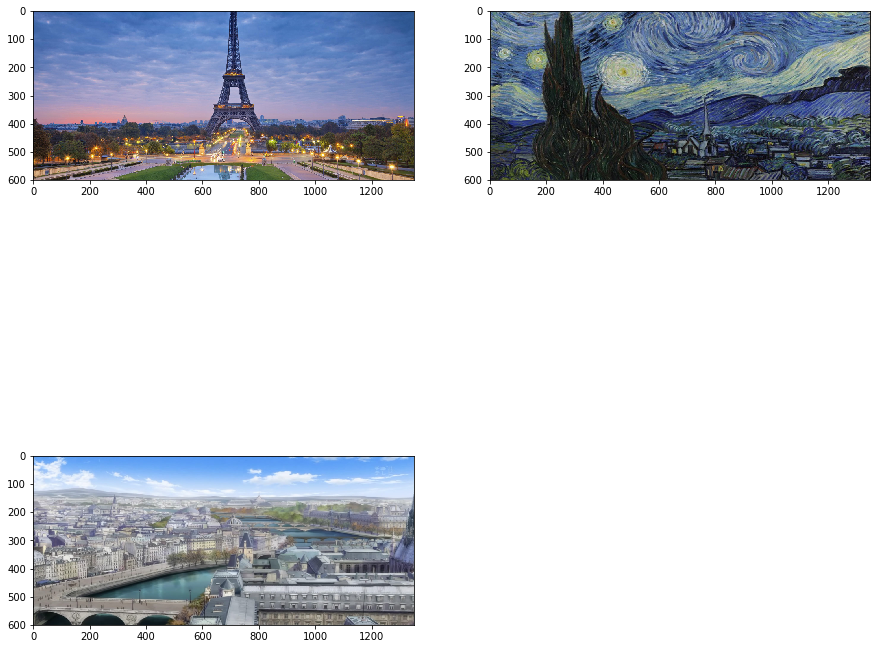

In [2]:
def load_image(path, resize=(775, 436)):
    img = cv2.imread(path)[:,:,::-1]
    if resize is not None:
        return cv2.resize(img, resize)
    return img

style_path = "vangogh.jpg" #style to apply
content_path = "paris.jpg" # image to transform
style_path2 = "Paris_19th_anime.jpg"



fig=plt.figure(figsize=(15, 15))
#(436, 775, 3)
# load style and content img
shape_style = (2699//2, 1200//2) # (content_img.shape[1], content_img.shape[0]) #
content_img = load_image(content_path, resize=shape_style )
style_img = load_image(style_path, shape_style)
style_img2 = load_image(style_path2, shape_style)



fig.add_subplot(2, 2, 1) # 1 row 2 column idx
plt.imshow(content_img)
fig.add_subplot(2, 2, 2)
plt.imshow(style_img)
fig.add_subplot(2, 2, 3)
plt.imshow(style_img2)
print(content_img.shape, style_img.shape)

# Load model

In [3]:
from tensorflow.keras.models import Model
def get_model(content_layers_name, style_layers_name):
    """
        The model is composed of VGG16 convolutions and return the content layer and style layer we want !
    """
    model = tf.keras.applications.vgg16.VGG16(include_top=False, weights='imagenet')
    #model = tf.keras.applications.mobilenet.MobileNet(include_top=False, weights='imagenet')
    model.trainable = False   
    style_layers = []
    content_layers = []
    
    for layer in model.layers:
        if layer.name in content_layers_name:
            content_layers.append(layer.output)
        elif layer.name in style_layers_name:
            style_layers.append(layer.output)
         
    return Model(model.input, style_layers+content_layers)

In [4]:
#model = tf.keras.applications.mobilenet.MobileNet(include_top=False, weights='imagenet')
#for layer in model.layers:
#    print(layer.name)

# Loss function

In [5]:
def content_loss(content_features_layer, target_features_layer):
    """
        content_features : features of the content image for one layer
        target_features : feature of the image desired (the image which is trained) in the content layer
    """

    return K.sum( K.square(content_features_layer - target_features_layer) )*0.5


def style_loss(style_features_layer, target_features_layer):
    """
        content_features : features of the content image for one layer
        target_features : feature of the image desired (the image which is trained) in the content layer
    """

    _, H, W, C = K.int_shape(style_features_layer)

    style_flatten = K.permute_dimensions( K.reshape(style_features_layer, (-1, C) ), (1,0))
    target_flatten = K.permute_dimensions( K.reshape(target_features_layer, (-1, C)), (1,0))
    
    gram_style = K.dot(style_flatten, K.transpose(style_flatten)) 
    gram_target = K.dot(target_flatten, K.transpose(target_flatten)) 
    #print(K.int_shape(gram_style))
    frac = 4 * (C**2) * ((H*W)**2)

    return K.sum(K.square(gram_style - gram_target)) / frac

def total_variation_loss(x):
    _, img_height, img_width, _ = K.int_shape(x) 
    a = K.square(
        x[:, :img_height - 1, :img_width - 1, :] - x[:, 1:, :img_width 
          - 1, :])
    b = K.square(
        x[:, :img_height - 1, :img_width - 1, :] - x[:, :img_height - 
          1, 1:, :])
    return K.sum(K.pow(a + b, 1.25))

def compute_loss(model, input_img, content_features, style_features, alpha=1.0, beta=1.0, sigma=0):
    """
    
    """
    
    target = model(input_img)
    target_features_content = target[-1]
    target_features_style =  target[:-1] 
    
    
    # compute content loss
    content_features = K.variable(content_features)
    
    loss_content = content_loss(content_features, target_features_content)
    
    loss_style = 0.
    
    
    for i in range(len(style_features)):

        style_features_curr = K.variable(style_features[i])

        w = 1/(i+1)
        #print(K.int_shape(style_features_curr), K.int_shape(target_features_style[i]))
        loss_style += (style_loss( style_features_curr, target_features_style[i] ) * w) 
     
    # total variation loss
    var = 0.
    if sigma != 0:
        var = total_variation_loss( input_img)
    # sum content and style loss
    totals = (alpha*loss_content) + (beta*loss_style) + (sigma * var)

    return totals

In [6]:
def style_transfer(model, input_img, content_img, style_img, lr=1.0, iterations=500, display_frequence=20, alpha=1.0, beta=1.0, sigma=0.0):
    # get features content and features style
    features_content = model.predict(np.expand_dims(content_img, 0))[-1]
    features_style = model.predict(np.expand_dims(style_img, 0))[:-1]
    
    row = iterations//display_frequence//2 + 1

    opt = tf.train.AdamOptimizer(learning_rate=lr, beta1=0.99, epsilon=1e-1)
    
    list_img = []
    for i in range(iterations):
        begin = time.time()
       

        
        #grads = K.gradients(loss, input_img)[0] can't used K.gradient with tf.eager
        with tf.GradientTape() as tape:
            loss_ = compute_loss(model, input_img, features_content, features_style, alpha, beta, sigma)
        grads = tape.gradient(loss_, input_img)
        
        #print(K.int_shape(grads))
        
        opt.apply_gradients([(grads, input_img)])
        temp = K.clip(input_img, 0, 255)
        input_img.assign(temp)
        #print("One iteration takes {} seconds".format(time.time()-begin))
        del grads, temp
        gc.collect()
        #print(K.int_shape(input_img))
        
        if i % display_frequence == 0:
            img = np.round(input_img.numpy()[0]).astype(np.uint8) #
            list_img.append(img)
    list_img.append(img)
    return list_img

In [7]:
def display_imgs(imgs, ncols=2, figsize=(15,15)):
    nrows = len(imgs)//2 if len(imgs)%2 == 0 else len(imgs)//2 +1
    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)

    # plot simple raster image on each sub-plot
    for i, axi in enumerate(ax.flat):
        # i runs from 0 to (nrows*ncols-1)
        # axi is equivalent with ax[rowid][colid]
        
        axi.imshow(imgs[i])
        
    plt.show()

In [8]:
# select content layers and style layers

In [9]:
content_layers_name = ["block5_conv3"]
style_layers_name = ["block1_conv1", "block2_conv1", "block3_conv1"]#, "block4_conv1"]#, "block5_conv1"]
model = get_model(content_layers_name, style_layers_name)

Instructions for updating:
Colocations handled automatically by placer.


In [25]:
input_img = tfe.Variable(np.expand_dims(content_img, 0), dtype=tf.float32)
imgs = style_transfer(model, input_img, content_img, style_img, lr=10.0, iterations=500, display_frequence=20,
                      alpha=0.5, beta=10.0, sigma = 0.1 )

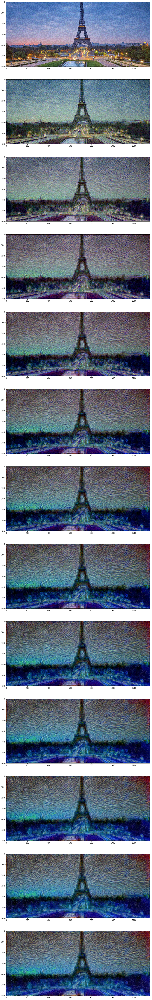

In [26]:
display_imgs(imgs, ncols=1, figsize=(100,100))

In [12]:
cv2.imwrite("paris_transfer_style.jpg",imgs[-1][:,:,::-1])

True

# Anime Style

In [31]:
input_img = tfe.Variable(np.expand_dims(content_img, 0), dtype=tf.float32)
imgs_anime = style_transfer(model, input_img, content_img, style_img2, lr=1, iterations=500, display_frequence=20,
                           alpha=0.5, beta=10.0, sigma = 0.01 )

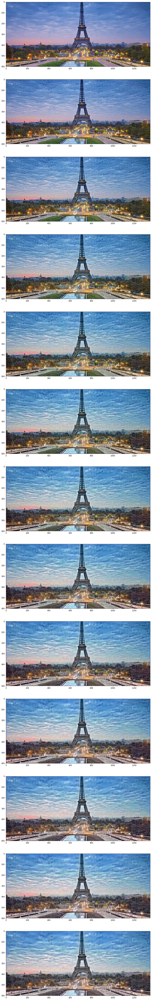

In [32]:
display_imgs(imgs_anime, ncols=1, figsize=(100,100))

In [15]:
#cv2.imwrite("paris_transfer_style_anime.jpg",imgs_anime[-1][:,:,::-1])